In [8]:
import sys
sys.path.insert(1, '/home/georgeos/Documents/GitHub/SyMBac/') # Not needed if you installed SyMBac using pip
sys.path.insert(1, '/home/georgeos/Documents/Github/SyMBac/') # Not needed if you installed SyMBac using pip

import ray
from SyMBac.drawing import raster_cell, OPL_to_FL
from SyMBac.PSF import PSF_generator
from SyMBac.renderer import convolve_rescale
import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm
from PIL import Image
from skimage.util import img_as_uint
import os
import zarr
from numcodecs import Blosc
from joblib import Parallel, delayed
from glob import glob
from SyMBac.colony_renderer import ColonyRenderer
import noise
from skimage.filters import threshold_otsu
from skimage.transform import rescale, resize, downscale_local_mean, rotate
from scipy.signal import find_peaks
import pandas as pd
from SyMBac.PSF import Camera

In [9]:
pad_amount = 200

radius = 150
wavelength = 0.6
NA = 1.45
n = 1.518
resize_amount = 1
pix_scaler = 1
pix_mic_conv = 0.065 / pix_scaler
apo_sigma = 11

FL_PSF = PSF_generator(
    radius = radius,
    wavelength = wavelength,
    NA = NA,
    n = n,
    resize_amount = resize_amount,
    pix_mic_conv = pix_mic_conv,
    apo_sigma = apo_sigma,
    mode="3d fluo",
    condenser = "Ph3",
    z_height = int(round(1/pix_mic_conv)),
    pz = 0.5,
    working_distance = 170
)
FL_PSF.calculate_PSF()
FL_PSF.kernel = np.sum(FL_PSF.kernel, axis=0)

In [10]:
def generate_membrane_cell(length, width, pad_amount=0):
    

    membrane_cells = []
        
    raster_cell_length = length
    raster_cell_width = width
    
    
    membrane_thickness = 0.2 #micron
    raster_membrane_thickness = membrane_thickness/pix_mic_conv * resize_amount
    cell_1 = raster_cell(length=round(raster_cell_length/2)*2, width=round(raster_cell_width/2)*2, separation = 0)
    cell_2 = raster_cell(length=round((raster_cell_length - raster_membrane_thickness)/2)*2, width=round((raster_cell_width - raster_membrane_thickness)/2)*2, separation = 0)
    pad_1 = int((cell_1.shape[0] - cell_2.shape[0])/2)    
    pad_2 = int((cell_1.shape[1] - cell_2.shape[1])/2)
    cell_2 = np.pad(cell_2, ((pad_1,pad_1), (pad_2, pad_2)))
    membrane_cell = cell_1 - cell_2

    raster_depth = np.max(cell_1)
    raster_cell_length, raster_cell_width = membrane_cell.shape
    
    membrane_cell = np.pad(membrane_cell,pad_amount).astype(np.float32) 
    return membrane_cell

In [11]:
def generate_agar_pad_image(border, img_size, density, iter_threshold):
    from SyMBac.PSF import Camera

    
    image = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border)))
    mask = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border)))
    mask_labaled = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border))).astype(np.uint)
     #DENSITY In cells per square micron
    n_cells = int(density * ((pix_mic_conv * img_size) ** 2))
    mask_counter = 0
    iterations = 0
    stop_condition = int(n_cells*iter_threshold)
    #pbar = tqdm(total=stop_condition)
    cell_info = []
    while (mask_counter != n_cells) and (iterations != stop_condition):

        cell_length = np.random.uniform(1, 3)
        cell_width = np.random.uniform(1, cell_length/2)

        raster_cell_length = cell_length/pix_mic_conv * resize_amount
        raster_cell_width = cell_width/pix_mic_conv * resize_amount

        rotation_angle = np.random.uniform(0,365)
        
        cell = generate_membrane_cell(length=raster_cell_length, width=raster_cell_width)
        cell = rotate(cell, angle=rotation_angle, resize=True, order = 0, preserve_range = True)
        cell *= int(np.random.uniform(1200,1400))


        
        cell = cell.astype(int)

        
        cell_mask = cell > 0
        pos_x_start = int(np.random.uniform(0, image.shape[1] - cell.shape[1]))
        pos_y_start = int(np.random.uniform(0, image.shape[0] - cell.shape[0]))
        if mask[pos_y_start + cell.shape[0]//2, pos_x_start + cell.shape[1]//2]:
            pass
        else:

            mask[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += cell_mask
            if np.sum(mask > 1) > 0:
                mask[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] -= cell_mask
            else:
                image[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += cell
                mask_labaled[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += (cell_mask * mask_counter).astype(np.uint)
                cell_info.append([mask_counter, cell_length, cell_width])
                mask_counter += 1
                
        iterations += 1
        #pbar.update(1)
    #pbar.close()

    return image, mask_labaled, cell_info

In [12]:
densities = np.random.uniform(0.01, 0.15, 100)

In [13]:
img_mask_pairs = Parallel(n_jobs=-1)(delayed(generate_agar_pad_image)(1, 1000, density, 2) for density in tqdm(densities)) 

  0%|          | 0/100 [00:00<?, ?it/s]

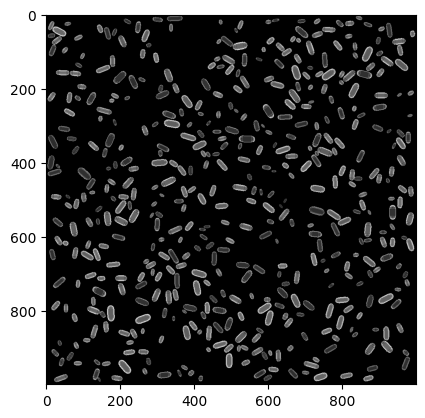

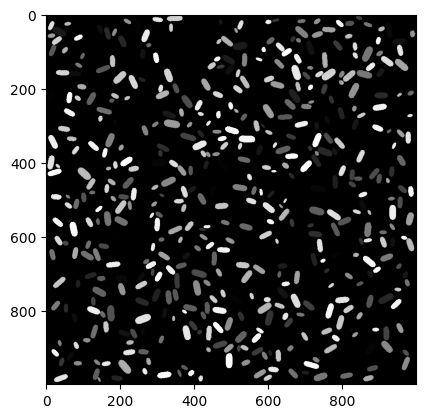

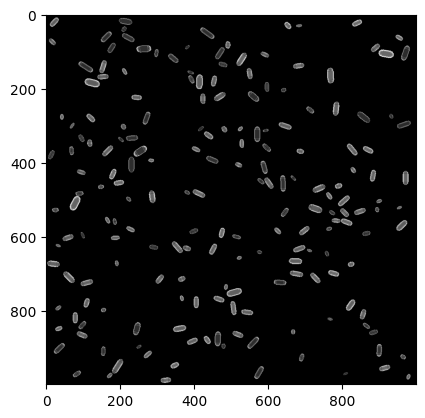

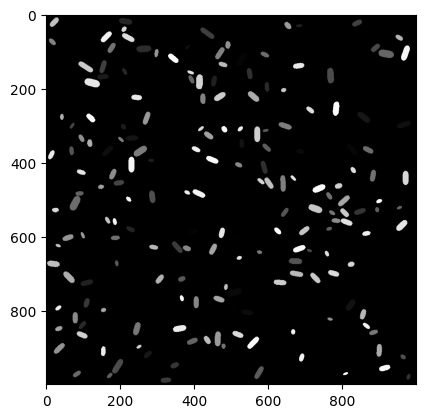

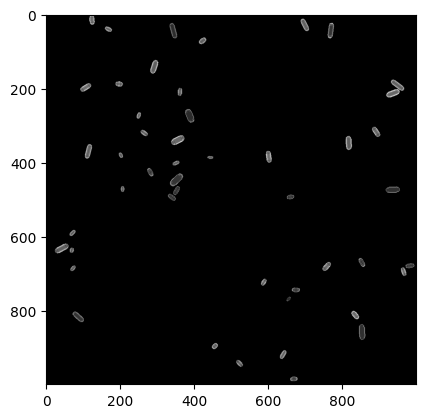

...

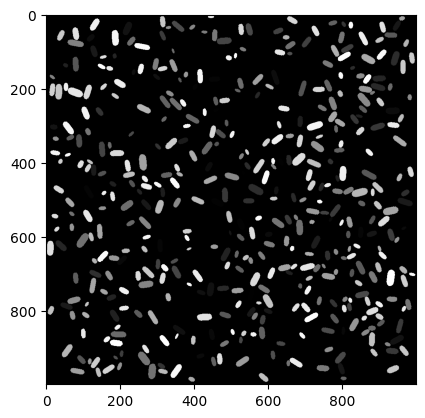

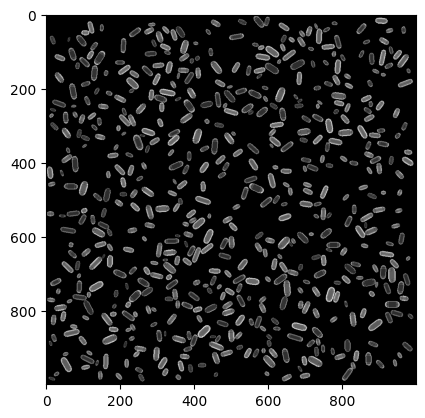

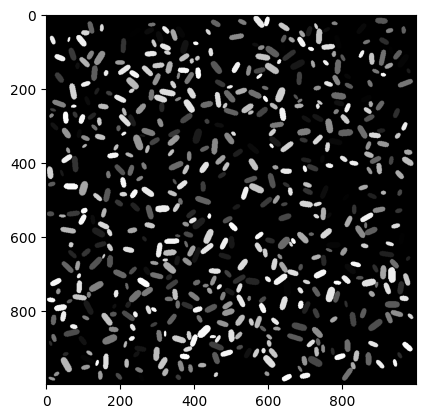

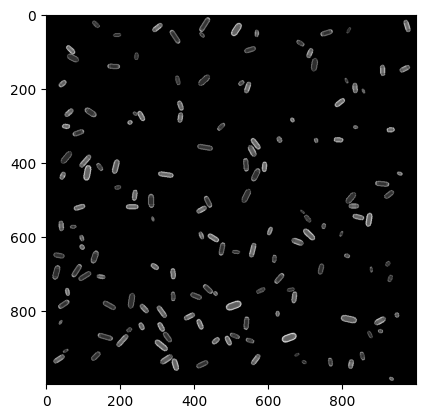

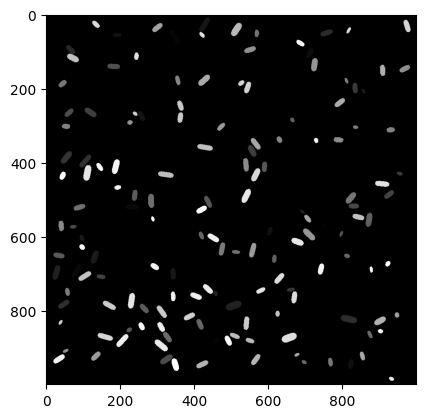

KeyboardInterrupt: 

In [15]:
for img, mask, cell_info in img_mask_pairs:
    plt.imshow(img, cmap="Greys_r")
    plt.show()
    plt.imshow(mask, cmap="Greys_r")
    plt.show()

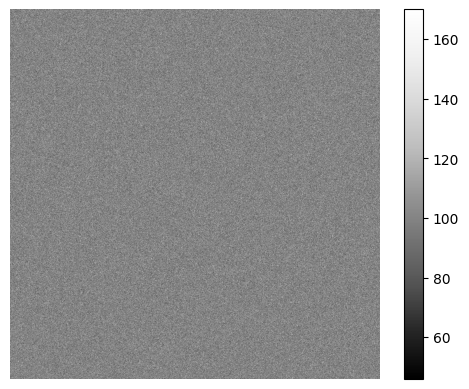

In [16]:
my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
dark_image = my_camera.render_dark_image(size=img.shape);

In [17]:
dark_image.mean()

100.012302

In [18]:
try:
    os.mkdir("membrane_training_data")
    os.mkdir("membrane_raw_images")
    os.mkdir("membrane_test_data")
    os.mkdir("membrane_raw_test_images")
except:
    pass

In [19]:
import cupy as cp

In [20]:
cp.convolve(cp.random.rand(100,100), cp.random.rand(100,100))

ValueError: v cannot be multidimensional array

  0%|          | 0/100 [00:00<?, ?it/s]

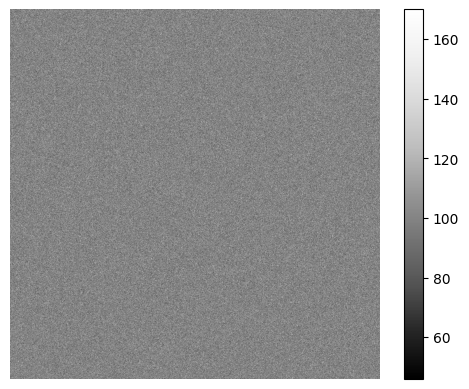

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 490 fits in uint16
  return _convert(image, np.uint16, force_copy)


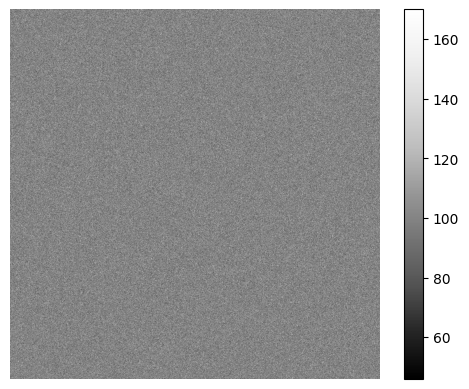

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 189 fits in uint16
  return _convert(image, np.uint16, force_copy)


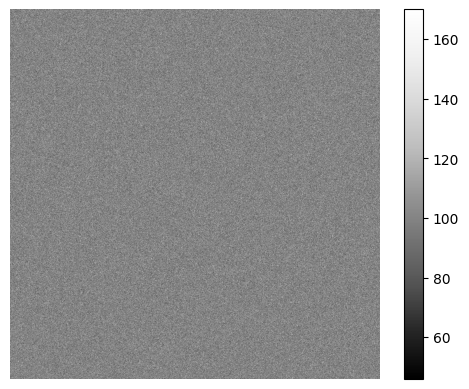

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 47 fits in uint16
  return _convert(image, np.uint16, force_copy)


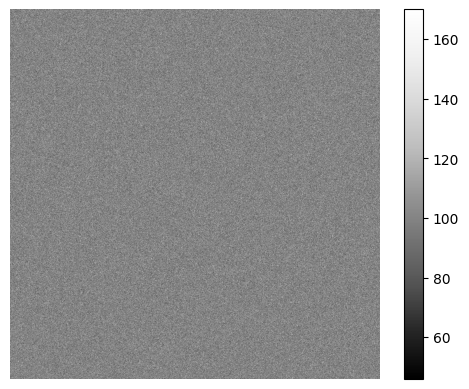

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 375 fits in uint16
  return _convert(image, np.uint16, force_copy)


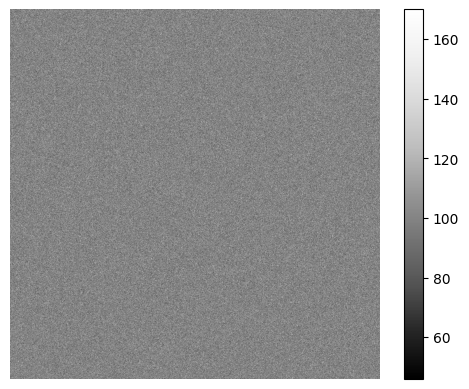

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 383 fits in uint16
  return _convert(image, np.uint16, force_copy)


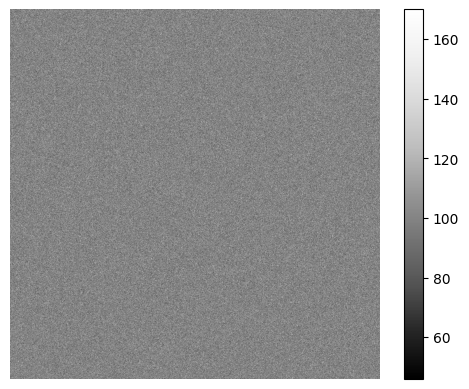

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 101 fits in uint16
  return _convert(image, np.uint16, force_copy)


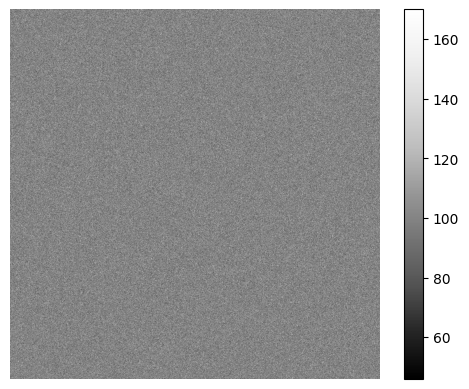

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 306 fits in uint16
  return _convert(image, np.uint16, force_copy)


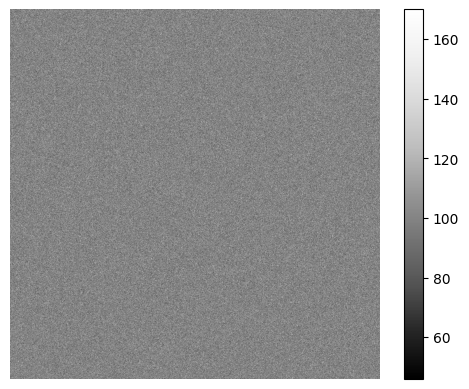

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 275 fits in uint16
  return _convert(image, np.uint16, force_copy)


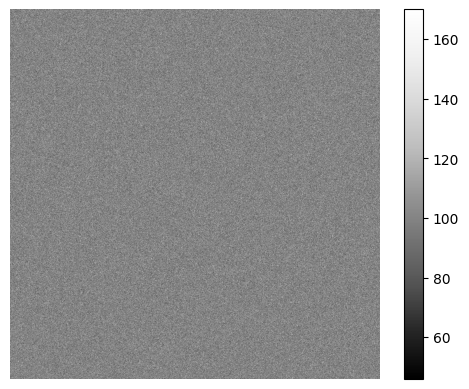

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 70 fits in uint16
  return _convert(image, np.uint16, force_copy)


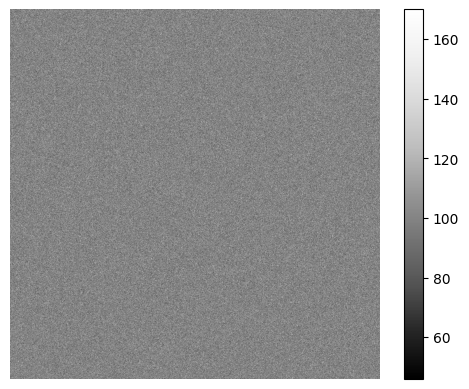

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 222 fits in uint16
  return _convert(image, np.uint16, force_copy)


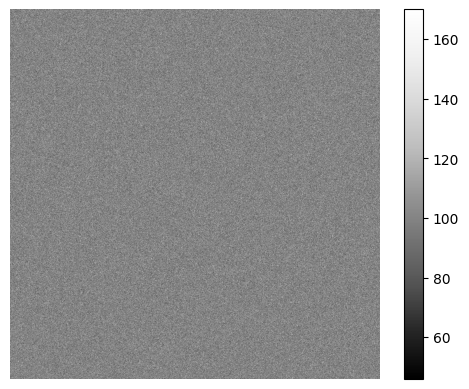

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 473 fits in uint16
  return _convert(image, np.uint16, force_copy)


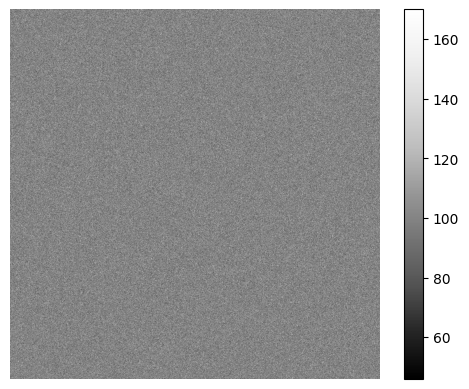

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 523 fits in uint16
  return _convert(image, np.uint16, force_copy)


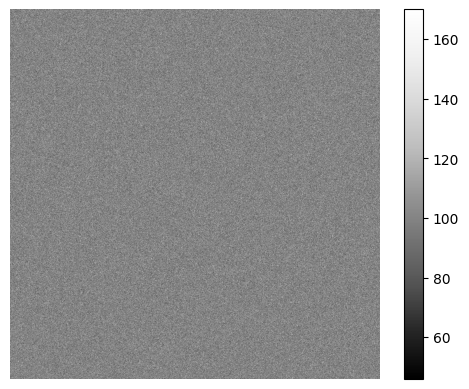

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 167 fits in uint16
  return _convert(image, np.uint16, force_copy)


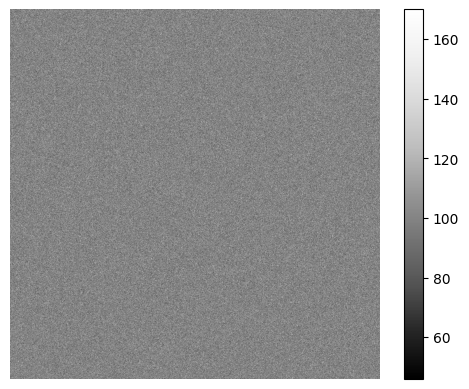

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 500 fits in uint16
  return _convert(image, np.uint16, force_copy)


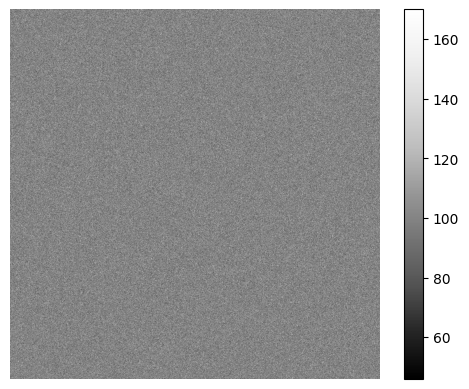

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 456 fits in uint16
  return _convert(image, np.uint16, force_copy)


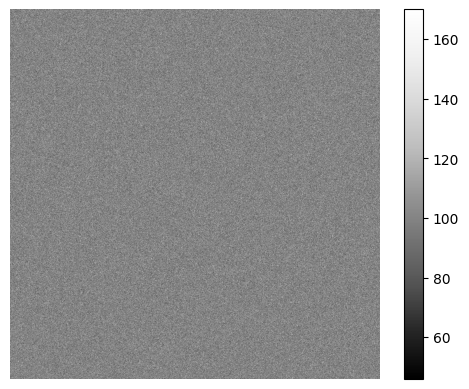

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 575 fits in uint16
  return _convert(image, np.uint16, force_copy)


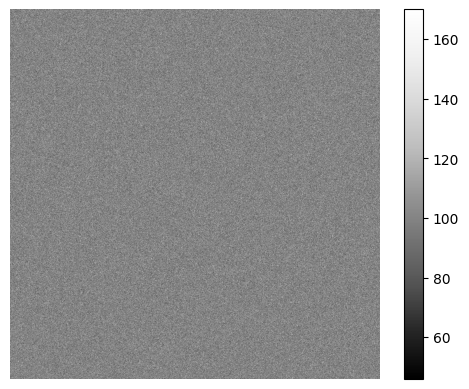

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 154 fits in uint16
  return _convert(image, np.uint16, force_copy)


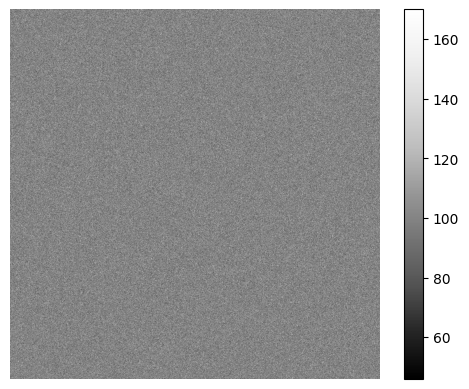

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 188 fits in uint16
  return _convert(image, np.uint16, force_copy)


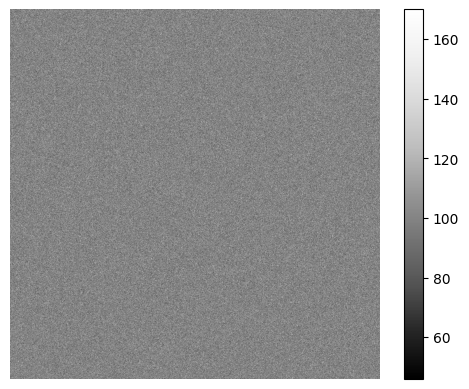

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 192 fits in uint16
  return _convert(image, np.uint16, force_copy)


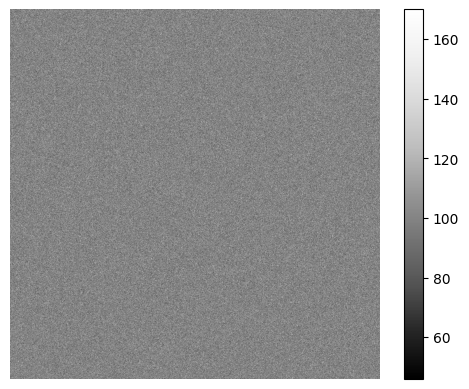

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 106 fits in uint16
  return _convert(image, np.uint16, force_copy)


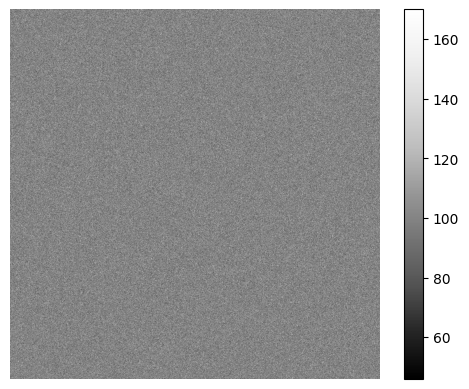

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 586 fits in uint16
  return _convert(image, np.uint16, force_copy)


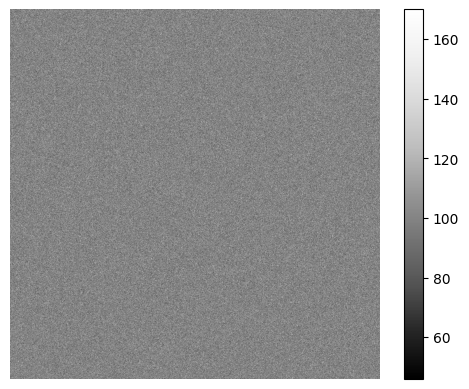

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 69 fits in uint16
  return _convert(image, np.uint16, force_copy)


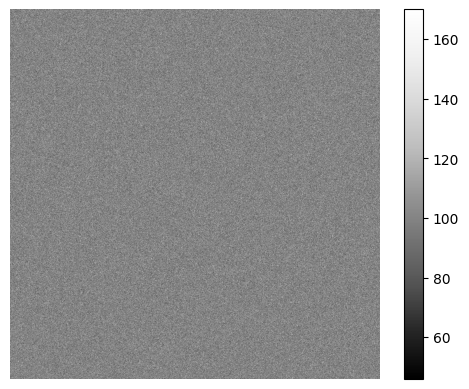

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 520 fits in uint16
  return _convert(image, np.uint16, force_copy)


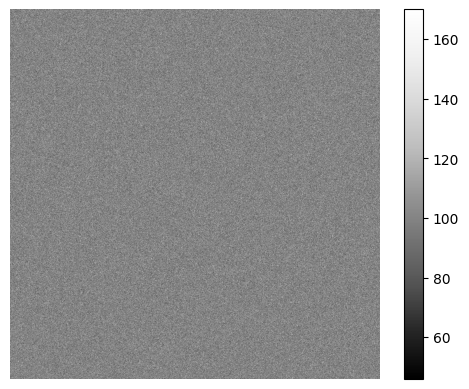

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 324 fits in uint16
  return _convert(image, np.uint16, force_copy)


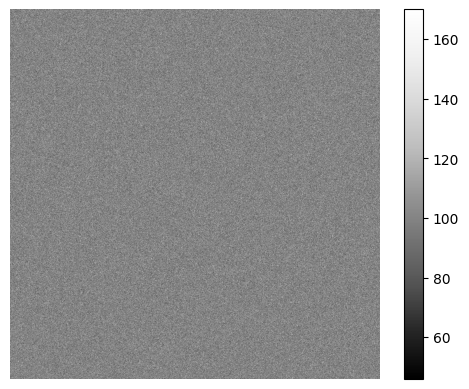

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 66 fits in uint16
  return _convert(image, np.uint16, force_copy)


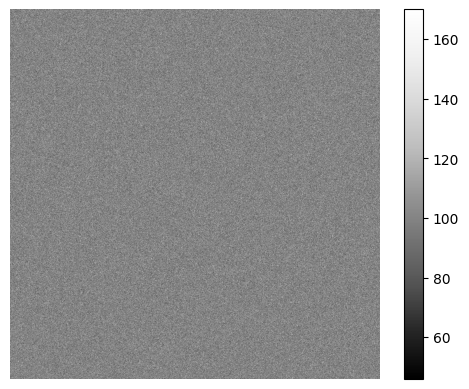

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 462 fits in uint16
  return _convert(image, np.uint16, force_copy)


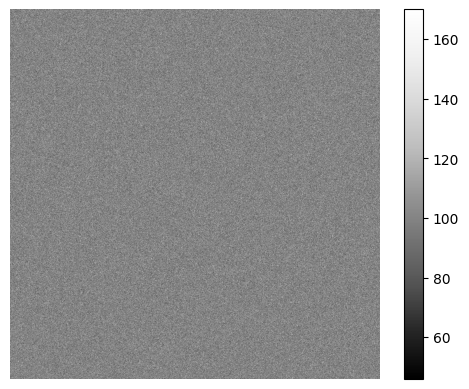

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 228 fits in uint16
  return _convert(image, np.uint16, force_copy)


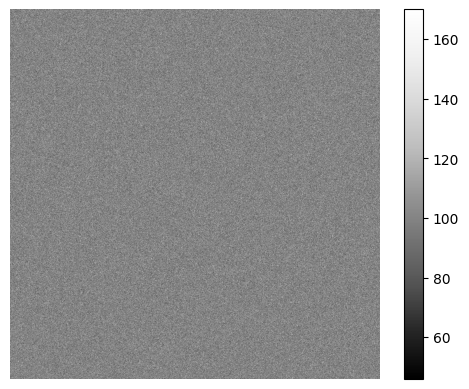

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 308 fits in uint16
  return _convert(image, np.uint16, force_copy)


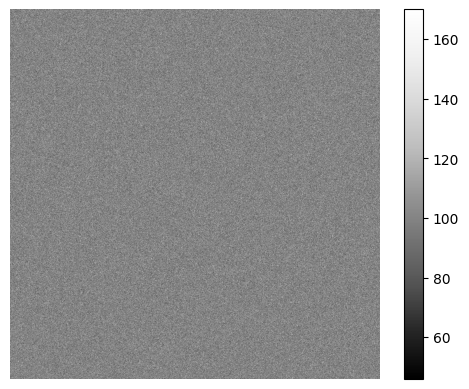

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 59 fits in uint16
  return _convert(image, np.uint16, force_copy)


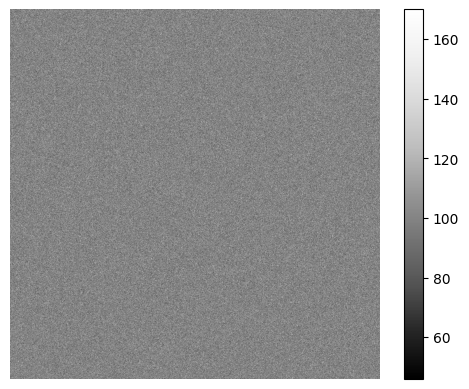

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 486 fits in uint16
  return _convert(image, np.uint16, force_copy)


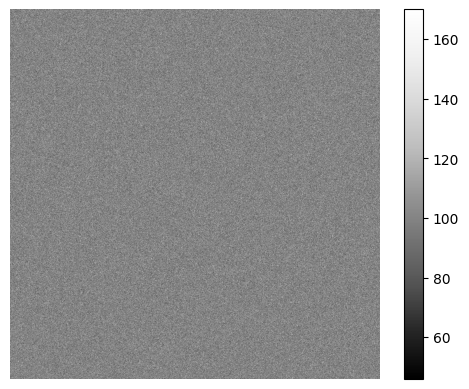

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 551 fits in uint16
  return _convert(image, np.uint16, force_copy)


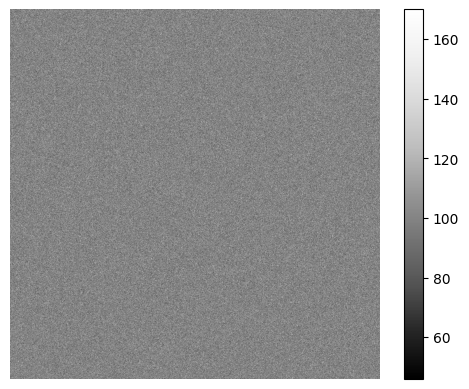

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 628 fits in uint16
  return _convert(image, np.uint16, force_copy)


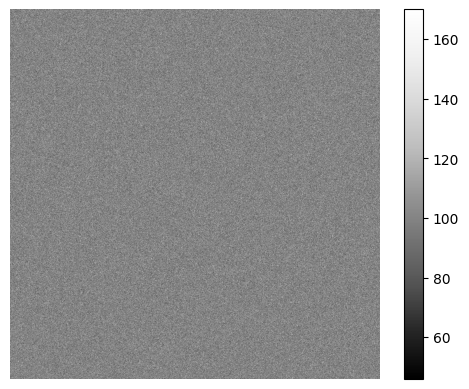

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 237 fits in uint16
  return _convert(image, np.uint16, force_copy)


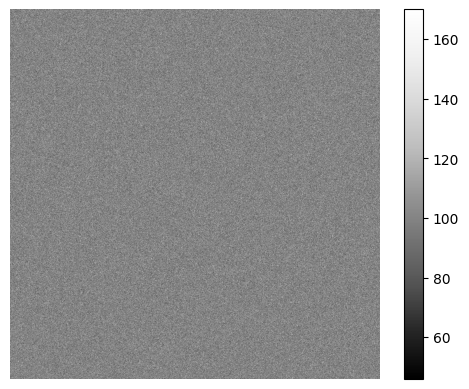

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 76 fits in uint16
  return _convert(image, np.uint16, force_copy)


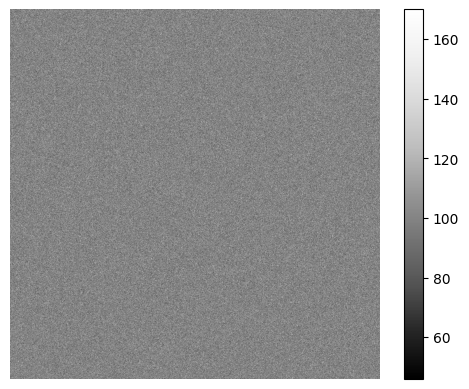

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 542 fits in uint16
  return _convert(image, np.uint16, force_copy)


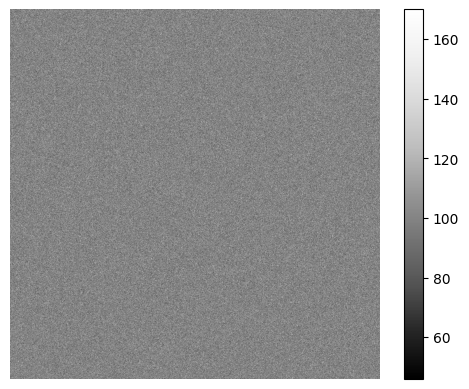

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 403 fits in uint16
  return _convert(image, np.uint16, force_copy)


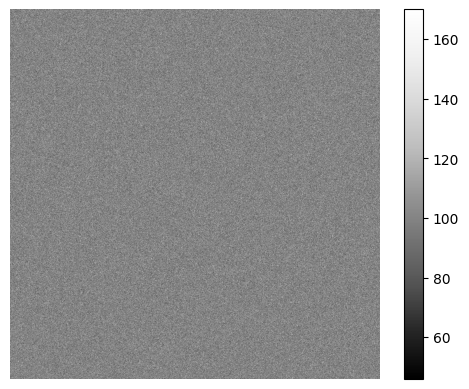

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 314 fits in uint16
  return _convert(image, np.uint16, force_copy)


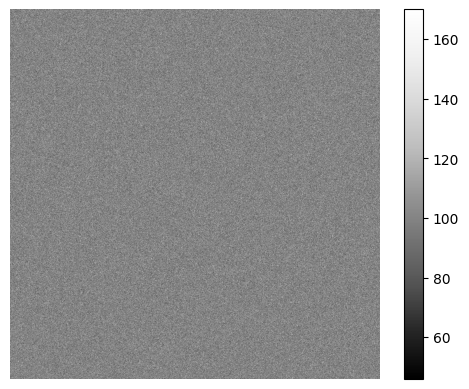

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 79 fits in uint16
  return _convert(image, np.uint16, force_copy)


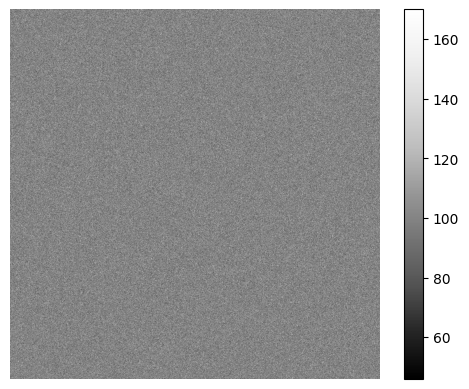

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 349 fits in uint16
  return _convert(image, np.uint16, force_copy)


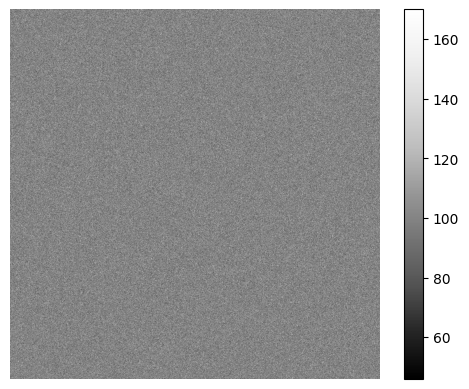

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 368 fits in uint16
  return _convert(image, np.uint16, force_copy)


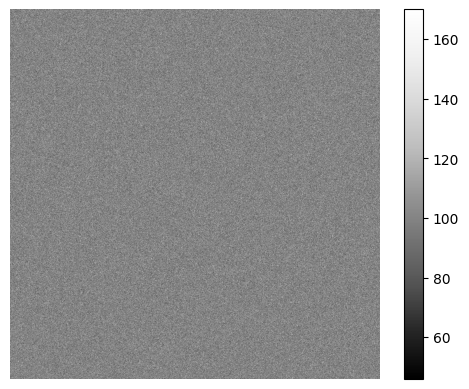

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 475 fits in uint16
  return _convert(image, np.uint16, force_copy)


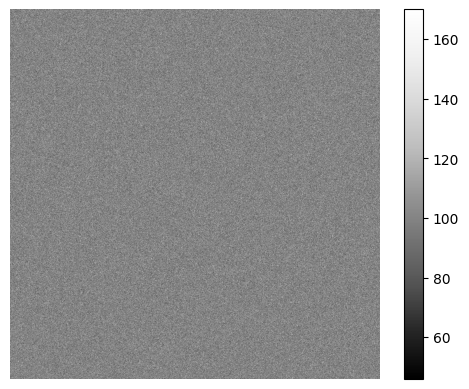

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 264 fits in uint16
  return _convert(image, np.uint16, force_copy)


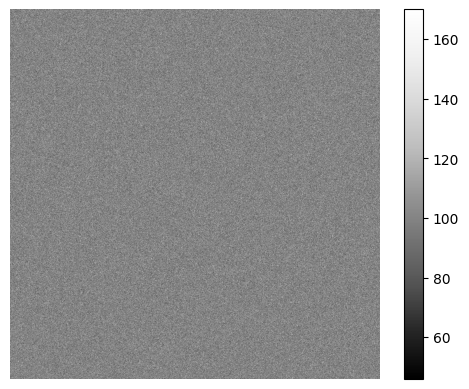

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 611 fits in uint16
  return _convert(image, np.uint16, force_copy)


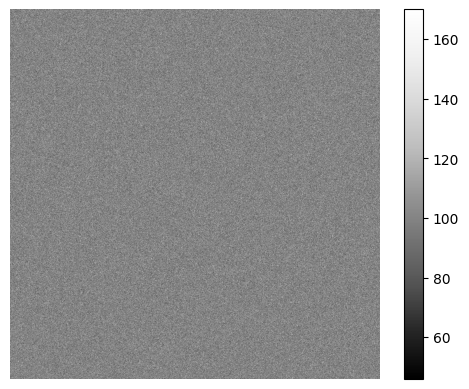

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 118 fits in uint16
  return _convert(image, np.uint16, force_copy)


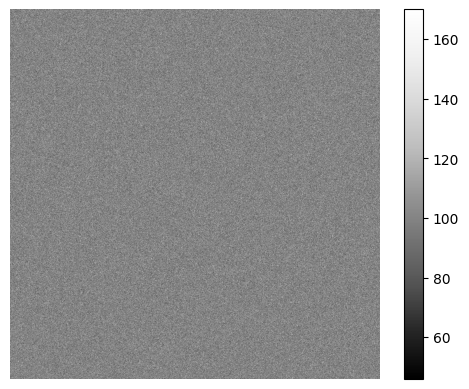

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 321 fits in uint16
  return _convert(image, np.uint16, force_copy)


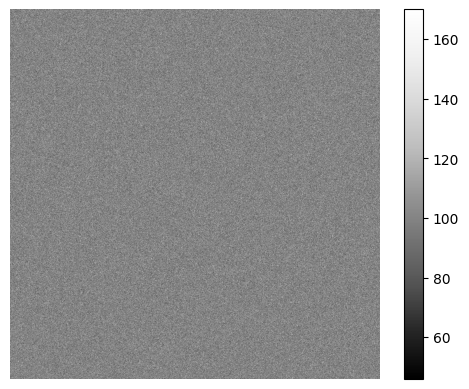

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 340 fits in uint16
  return _convert(image, np.uint16, force_copy)


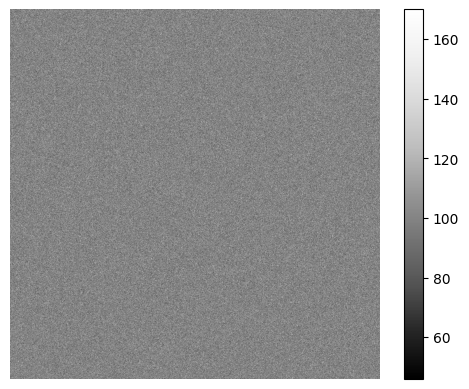

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 466 fits in uint16
  return _convert(image, np.uint16, force_copy)


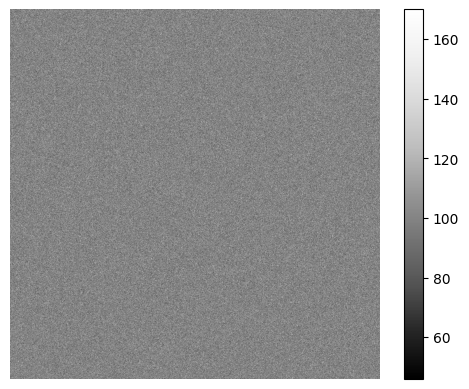

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 529 fits in uint16
  return _convert(image, np.uint16, force_copy)


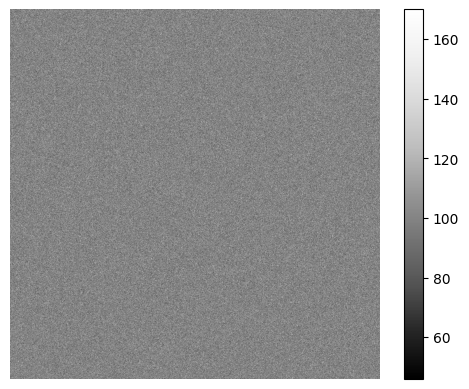

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 351 fits in uint16
  return _convert(image, np.uint16, force_copy)


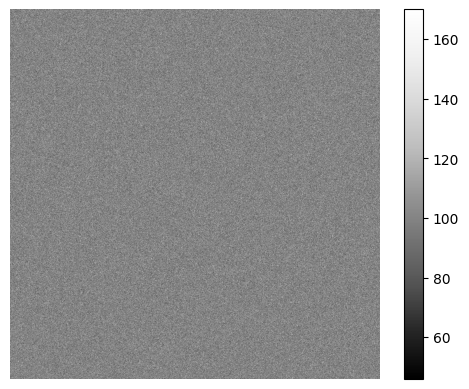

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 487 fits in uint16
  return _convert(image, np.uint16, force_copy)


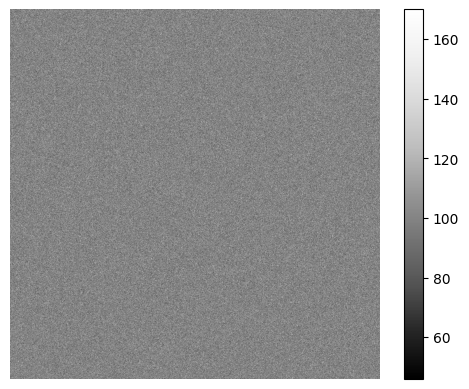

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 246 fits in uint16
  return _convert(image, np.uint16, force_copy)


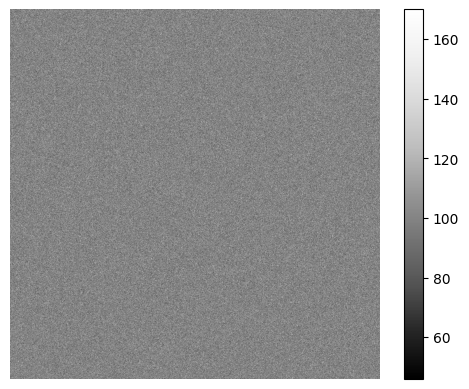

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 184 fits in uint16
  return _convert(image, np.uint16, force_copy)


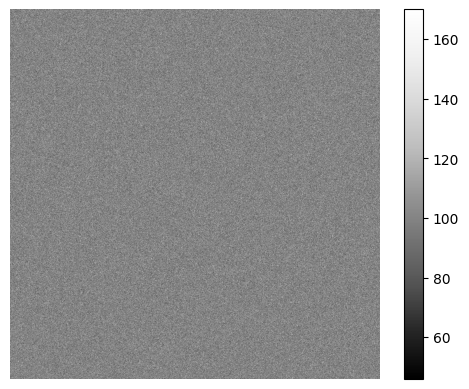

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 269 fits in uint16
  return _convert(image, np.uint16, force_copy)


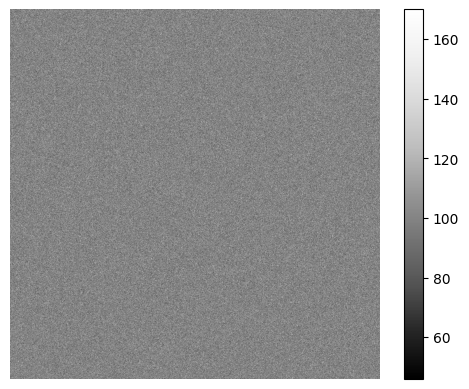

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 554 fits in uint16
  return _convert(image, np.uint16, force_copy)


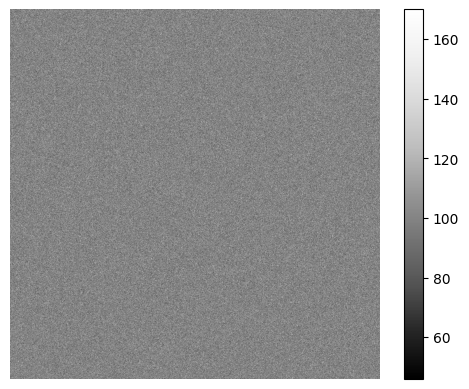

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 193 fits in uint16
  return _convert(image, np.uint16, force_copy)


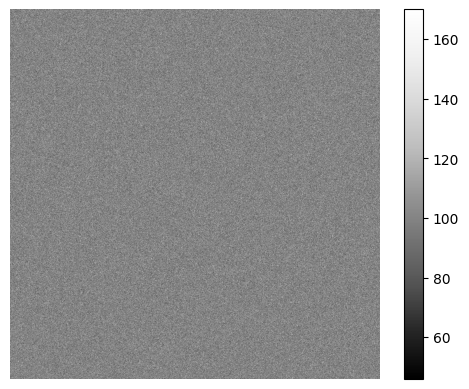

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 293 fits in uint16
  return _convert(image, np.uint16, force_copy)


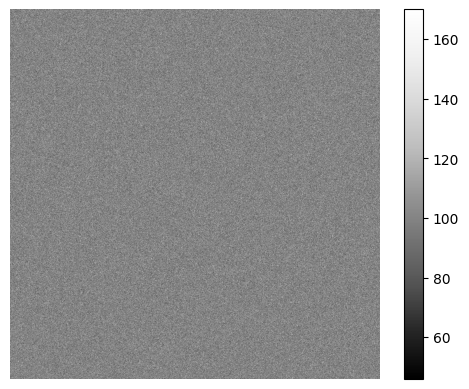

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 423 fits in uint16
  return _convert(image, np.uint16, force_copy)


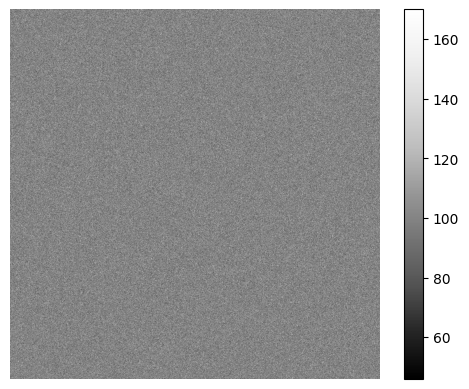

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 513 fits in uint16
  return _convert(image, np.uint16, force_copy)


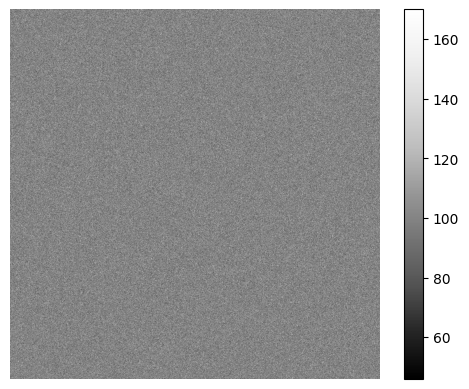

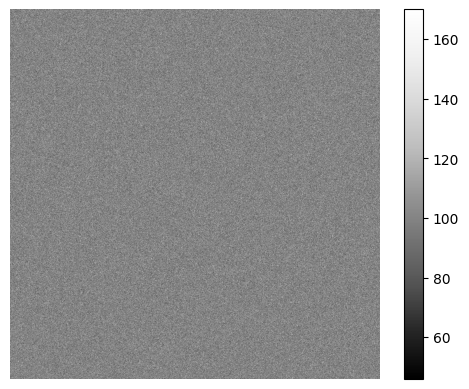

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 392 fits in uint16
  return _convert(image, np.uint16, force_copy)


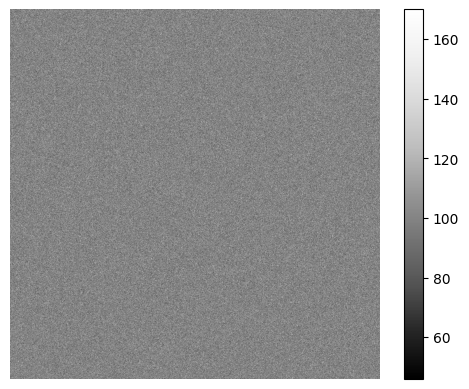

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 505 fits in uint16
  return _convert(image, np.uint16, force_copy)


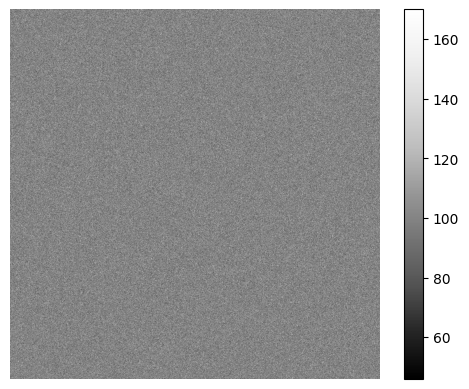

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 382 fits in uint16
  return _convert(image, np.uint16, force_copy)


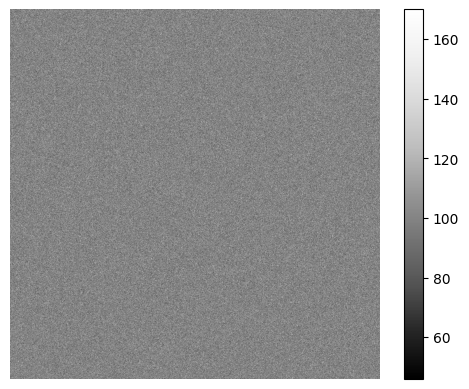

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 420 fits in uint16
  return _convert(image, np.uint16, force_copy)


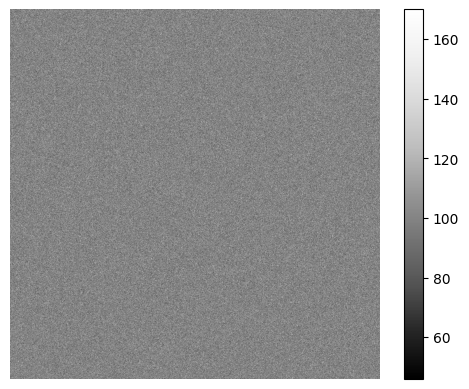

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 342 fits in uint16
  return _convert(image, np.uint16, force_copy)


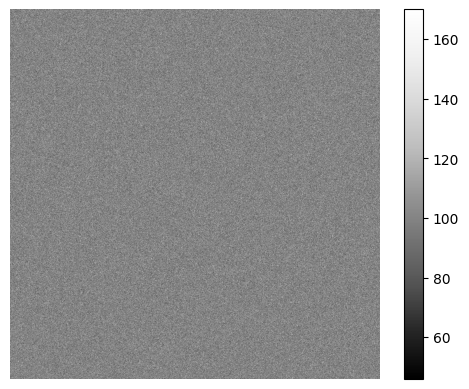

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 283 fits in uint16
  return _convert(image, np.uint16, force_copy)


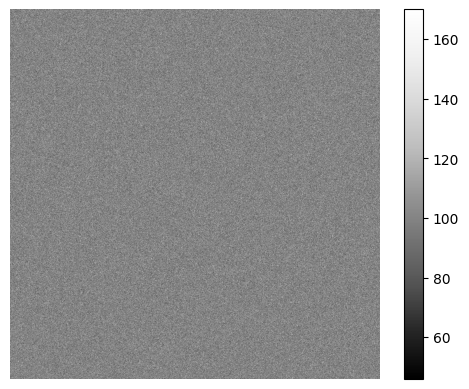

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 470 fits in uint16
  return _convert(image, np.uint16, force_copy)


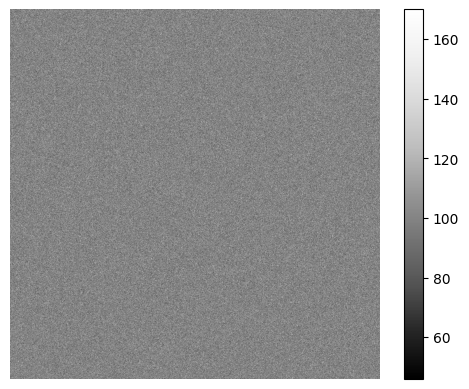

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 515 fits in uint16
  return _convert(image, np.uint16, force_copy)


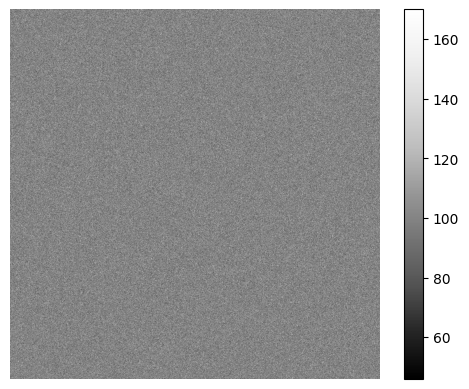

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 569 fits in uint16
  return _convert(image, np.uint16, force_copy)


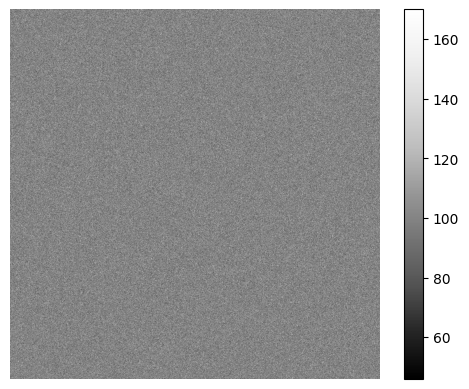

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 274 fits in uint16
  return _convert(image, np.uint16, force_copy)


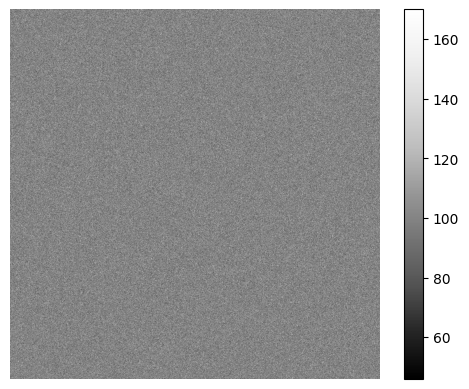

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 88 fits in uint16
  return _convert(image, np.uint16, force_copy)


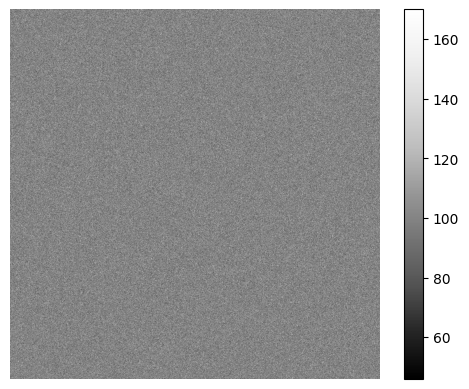

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 96 fits in uint16
  return _convert(image, np.uint16, force_copy)


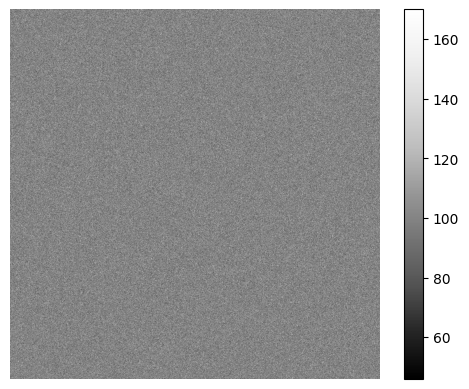

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 620 fits in uint16
  return _convert(image, np.uint16, force_copy)


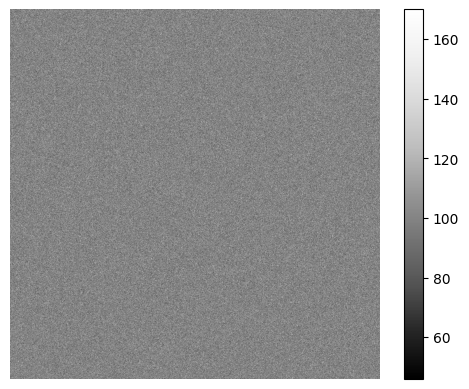

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 271 fits in uint16
  return _convert(image, np.uint16, force_copy)


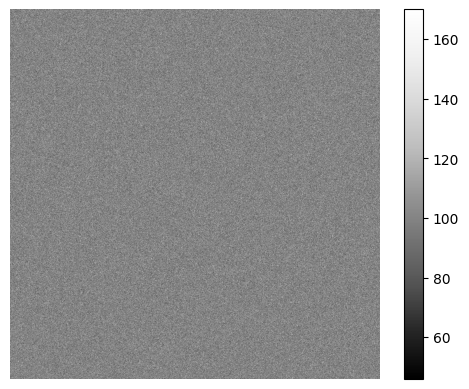

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 270 fits in uint16
  return _convert(image, np.uint16, force_copy)


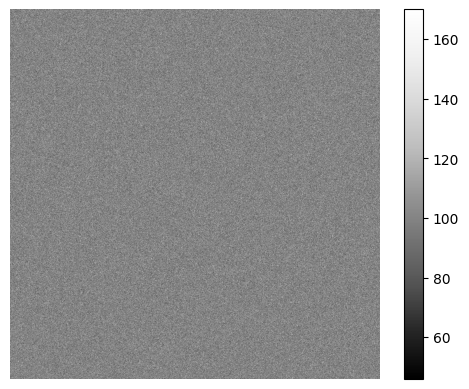

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 208 fits in uint16
  return _convert(image, np.uint16, force_copy)


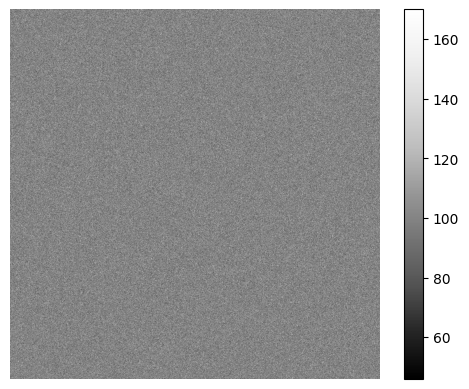

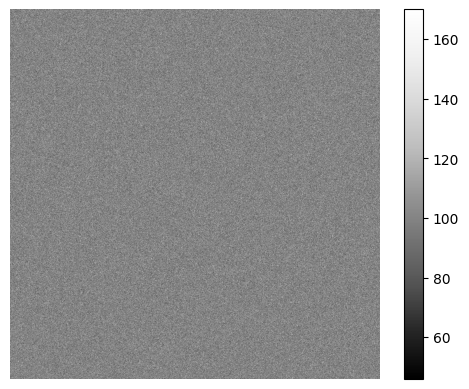

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 175 fits in uint16
  return _convert(image, np.uint16, force_copy)


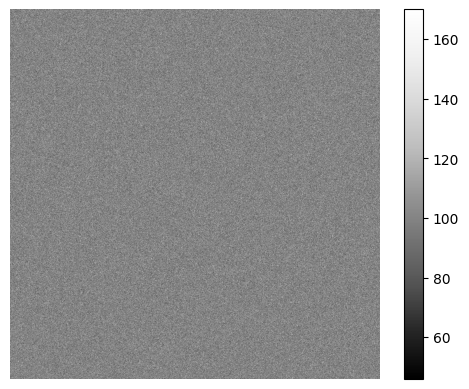

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 414 fits in uint16
  return _convert(image, np.uint16, force_copy)


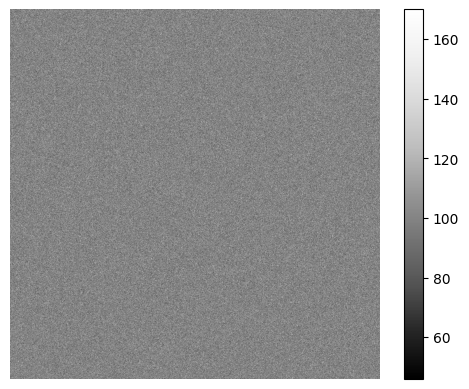

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 173 fits in uint16
  return _convert(image, np.uint16, force_copy)


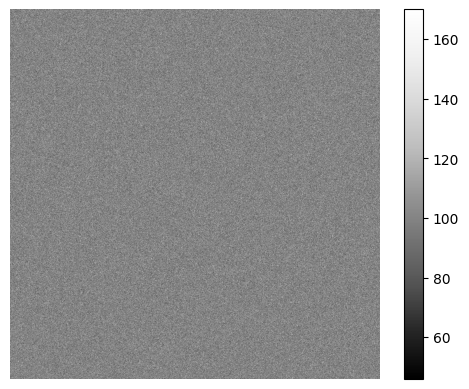

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 212 fits in uint16
  return _convert(image, np.uint16, force_copy)


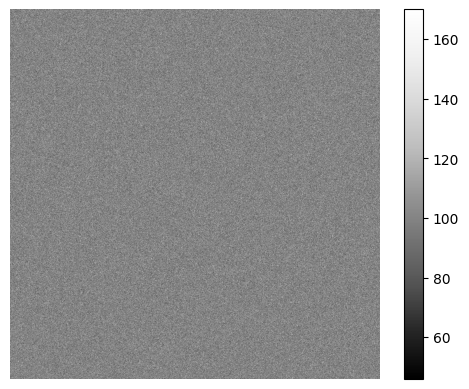

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 624 fits in uint16
  return _convert(image, np.uint16, force_copy)


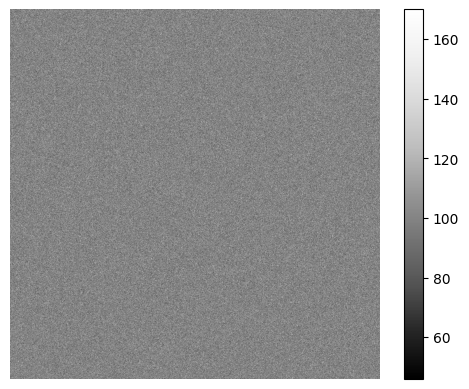

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 311 fits in uint16
  return _convert(image, np.uint16, force_copy)


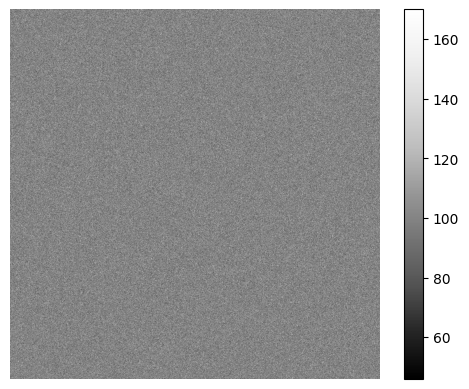

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 245 fits in uint16
  return _convert(image, np.uint16, force_copy)


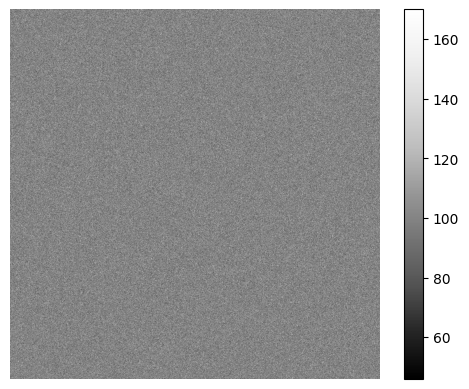

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 558 fits in uint16
  return _convert(image, np.uint16, force_copy)


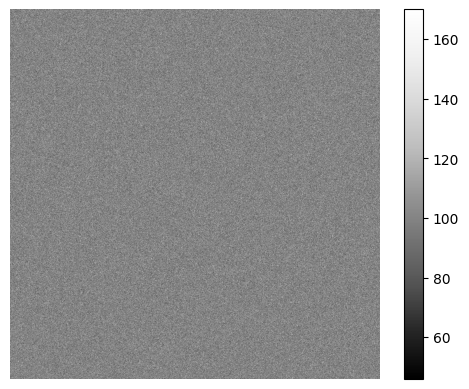

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 62 fits in uint16
  return _convert(image, np.uint16, force_copy)


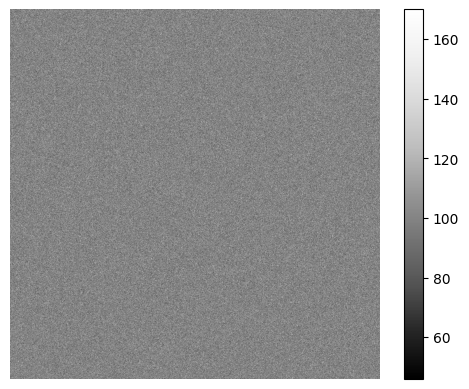

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 535 fits in uint16
  return _convert(image, np.uint16, force_copy)


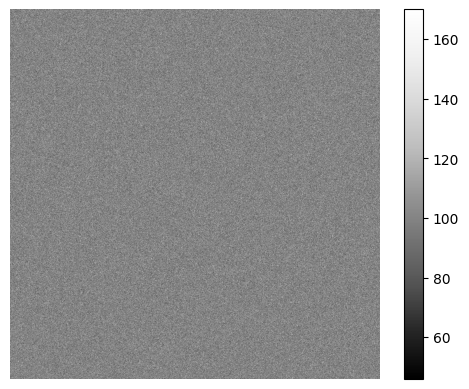

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 559 fits in uint16
  return _convert(image, np.uint16, force_copy)


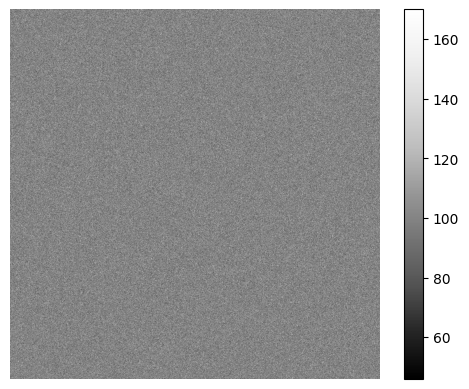

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 451 fits in uint16
  return _convert(image, np.uint16, force_copy)


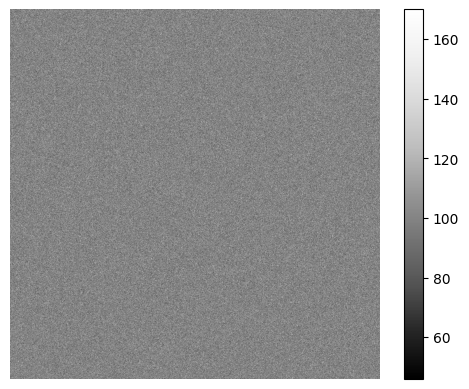

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 54 fits in uint16
  return _convert(image, np.uint16, force_copy)


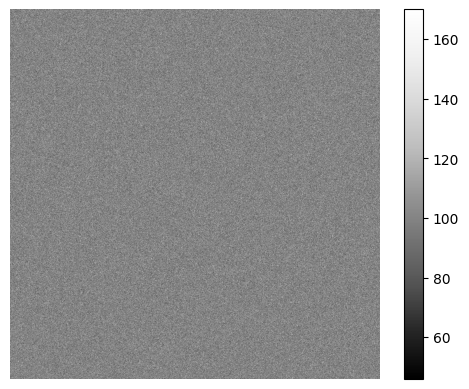

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 623 fits in uint16
  return _convert(image, np.uint16, force_copy)


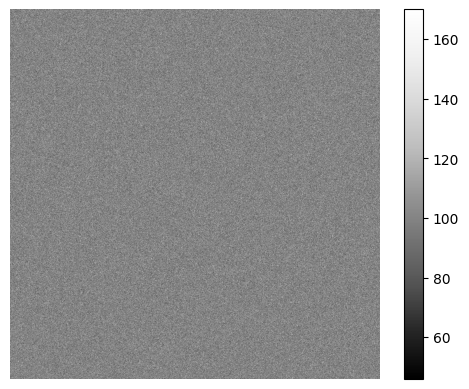

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 200 fits in uint16
  return _convert(image, np.uint16, force_copy)


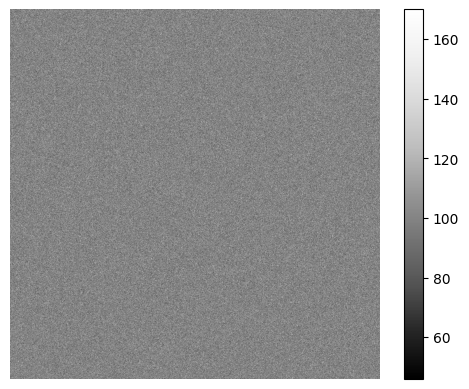

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 388 fits in uint16
  return _convert(image, np.uint16, force_copy)


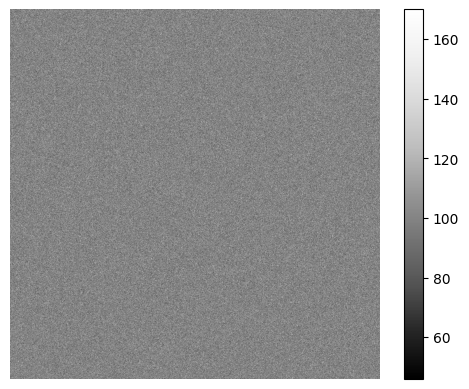

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 588 fits in uint16
  return _convert(image, np.uint16, force_copy)


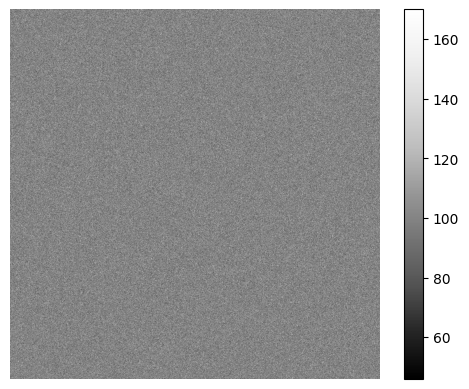

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 195 fits in uint16
  return _convert(image, np.uint16, force_copy)


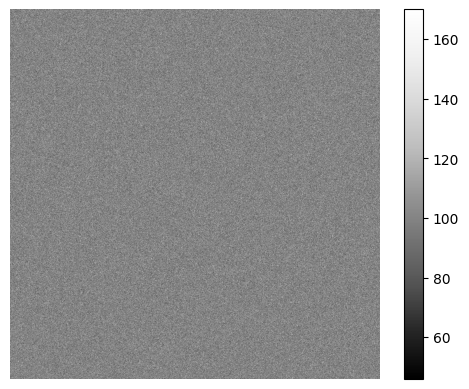

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 448 fits in uint16
  return _convert(image, np.uint16, force_copy)


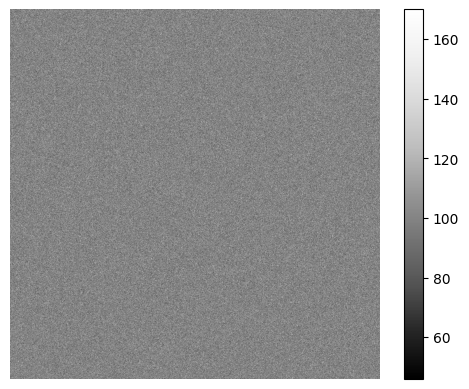

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 525 fits in uint16
  return _convert(image, np.uint16, force_copy)


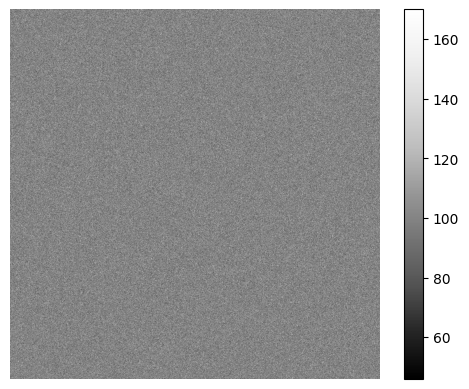

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 260 fits in uint16
  return _convert(image, np.uint16, force_copy)


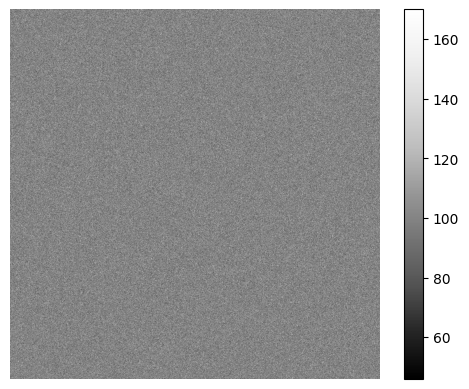

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 109 fits in uint16
  return _convert(image, np.uint16, force_copy)


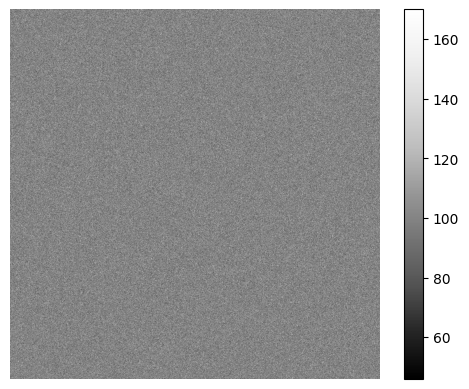

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 355 fits in uint16
  return _convert(image, np.uint16, force_copy)


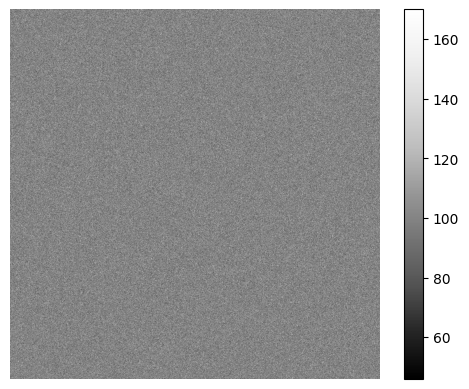

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 92 fits in uint16
  return _convert(image, np.uint16, force_copy)


In [21]:
conv_imgs = []
for a, (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)):
    my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
    dark_image = my_camera.render_dark_image(size=image.shape);
    conv_image = convolve_rescale(image, FL_PSF.kernel, rescale_factor=1/pix_scaler, rescale_int=True)
    conv_image = (dark_image + conv_image * 1000)
    conv_image /= conv_image.max()
    Image.fromarray(img_as_uint(conv_image/conv_image.max())).save(f"membrane_training_data/{str(a).zfill(4)}.png")
    Image.fromarray(img_as_uint(mask)).save(f"membrane_training_data/{str(a).zfill(4)}_masks.png")
    Image.fromarray(img_as_uint(image/image.max())).save(f"membrane_raw_images/{str(a).zfill(4)}.png")
    np.save(f"membrane_raw_images/{str(a).zfill(4)}.npy", np.array(cell_info))

In [22]:
#for a, (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)):
def generate_test_data(a, image, mask, cell_info):
    my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
    dark_image = my_camera.render_dark_image(size=image.shape);
    conv_image = convolve_rescale(image, FL_PSF.kernel, rescale_factor=1/pix_scaler, rescale_int=True)
    conv_image = (dark_image + conv_image * 1000)
    conv_image /= conv_image.max()
    Image.fromarray(img_as_uint(conv_image/conv_image.max())).save(f"membrane_test_data/{str(a).zfill(4)}.png")
    Image.fromarray(img_as_uint(mask)).save(f"membrane_test_data/{str(a).zfill(4)}_masks.png")
    Image.fromarray(img_as_uint(image/image.max())).save(f"membrane_raw_test_images/{str(a).zfill(4)}.png")
    np.save(f"membrane_raw_test_images/{str(a).zfill(4)}.npy", np.array(cell_info))

In [23]:
img_mask_pairs = Parallel(n_jobs=-1)(delayed(generate_agar_pad_image)(1, 1000, density, 2) for density in tqdm(densities)) 

  0%|          | 0/100 [00:00<?, ?it/s]

In [24]:
_ = Parallel(n_jobs=-1)(delayed(generate_test_data)(a, image, mask, cell_info) for a , (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)))

  0%|          | 0/100 [00:00<?, ?it/s]

/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 490 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 47 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 375 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 189 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 586 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 500 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 306 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/

Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 575 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 473 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 222 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 456 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/

Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 66 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 462 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 228 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 59 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 551 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 628 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 308 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 486 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 403 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 237 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 349 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 368 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 76 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 542 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 611 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 314 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 79 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 466 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/skimage/util/dtype.py:501: UserWarning: Downcasting uint64 to uint16 without scaling because max value 264 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/gh464/miniconda3/envs/symbac/lib/python3.10/site-packages/s

Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(6